# Setup

In [ ]:
!pip install -r requirements.txt

In [ ]:
!python setup.py install

In [1]:
import os
import sys
import json
import shutil
import datetime
import cv2
import numpy as np
import skimage.draw
from tensorflow import keras

from mrcnn.visualize import display_instances, display_top_masks
from mrcnn.utils import extract_bboxes

from mrcnn.utils import Dataset
from matplotlib import pyplot as plt

from mrcnn.config import Config
from mrcnn.model import MaskRCNN


from mrcnn import model as modellib, utils
from PIL import Image, ImageDraw

from mrcnn.model import load_image_gt
from mrcnn.model import mold_image
from mrcnn.utils import compute_ap
from numpy import expand_dims
from numpy import mean
from matplotlib.patches import Rectangle

Using TensorFlow backend.


# Train

## CONSTANTS

In [2]:
!ls pantograph_dataset

anotations_old_60only.json  labels_my-project-name_2024-10-23-06-17-42.json
images


In [3]:
# Import Mask RCNN
ROOT_DIR = os.path.abspath("./")
sys.path.append(ROOT_DIR)  # To find local version of the library
DEFAULT_LOGS_DIR = os.path.join(ROOT_DIR, "logs") # Directory to save logs and trained model
COCO_WEIGHTS_PATH = os.path.join(ROOT_DIR, "mask_rcnn_coco.h5") # Path to trained weights file
# DATA
ANNOTATIONS = os.path.join('.', 'pantograph_dataset', 'labels_my-project-name_2024-10-23-06-17-42.json')
IMAGES = os.path.join('.', 'pantograph_dataset', 'images')

## Declarations

In [4]:
# Dataset class declare
class CocoLikeDataset(utils.Dataset):
    """ Generates a COCO-like dataset, i.e. an image dataset annotated in the style of the COCO dataset.
        See http://cocodataset.org/#home for more information.
    """
    def load_data(self, annotation_json, images_dir):
        """ Load the coco-like dataset from json
        Args:
            annotation_json: The path to the coco annotations json file
            images_dir: The directory holding the images referred to by the json file
        """
        # Load json from file
        json_file = open(annotation_json)
        coco_json = json.load(json_file)
        json_file.close()
        
        # Add the class names using the base method from utils.Dataset
        source_name = "coco_like"
        for category in coco_json['categories']:
            class_id = category['id']
            class_name = category['name']
            if class_id < 1:
                print('Error: Class id for "{}" cannot be less than one. (0 is reserved for the background)'.format(class_name))
                return
            
            self.add_class(source_name, class_id, class_name)
        
        # Get all annotations
        annotations = {}
        for annotation in coco_json['annotations']:
            image_id = annotation['image_id']
            if image_id not in annotations:
                annotations[image_id] = []
            annotations[image_id].append(annotation)
        
        # Get all images and add them to the dataset
        seen_images = {}
        for image in coco_json['images']:
            image_id = image['id']
            if image_id in seen_images:
                print("Warning: Skipping duplicate image id: {}".format(image))
            else:
                seen_images[image_id] = image
                try:
                    image_file_name = image['file_name']
                    image_width = image['width']
                    image_height = image['height']
                except KeyError as key:
                    print("Warning: Skipping image (id: {}) with missing key: {}".format(image_id, key))
                
                image_path = os.path.abspath(os.path.join(images_dir, image_file_name))
                image_annotations = annotations[image_id]
                
                # Add the image using the base method from utils.Dataset
                self.add_image(
                    source=source_name,
                    image_id=image_id,
                    path=image_path,
                    width=image_width,
                    height=image_height,
                    annotations=image_annotations
                )
                
    def load_mask(self, image_id):
        """ Load instance masks for the given image.
        MaskRCNN expects masks in the form of a bitmap [height, width, instances].
        Args:
            image_id: The id of the image to load masks for
        Returns:
            masks: A bool array of shape [height, width, instance count] with
                one mask per instance.
            class_ids: a 1D array of class IDs of the instance masks.
        """
        image_info = self.image_info[image_id]
        annotations = image_info['annotations']
        instance_masks = []
        class_ids = []
        
        for annotation in annotations:
            class_id = annotation['category_id']
            mask = Image.new('1', (image_info['width'], image_info['height']))
            mask_draw = ImageDraw.ImageDraw(mask, '1')
            for segmentation in annotation['segmentation']:
                mask_draw.polygon(segmentation, fill=1)
                bool_array = np.array(mask) > 0
                instance_masks.append(bool_array)
                class_ids.append(class_id)

        mask = np.dstack(instance_masks)
        class_ids = np.array(class_ids, dtype=np.int32)
        
        return mask, class_ids

In [5]:
# instanciate datasets
dataset_train = CocoLikeDataset()
dataset_train.load_data(ANNOTATIONS, IMAGES)
dataset_train.prepare()

dataset_val = CocoLikeDataset()
dataset_val.load_data(ANNOTATIONS, IMAGES)
dataset_val.prepare()

## Dataset Preview

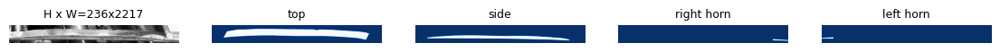

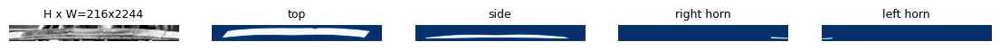

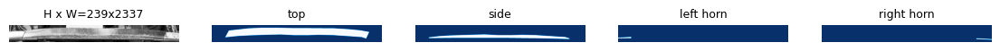

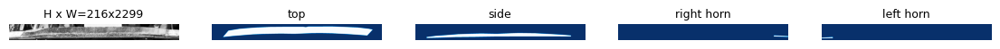

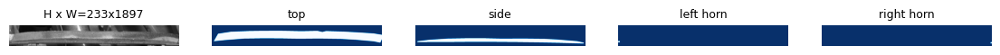

...

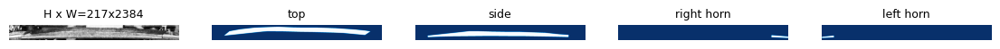

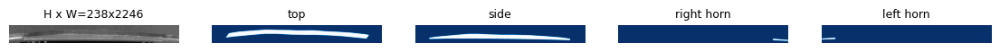

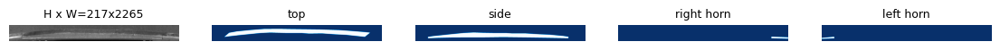

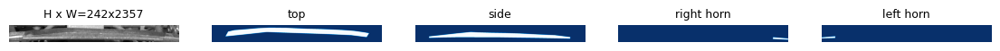

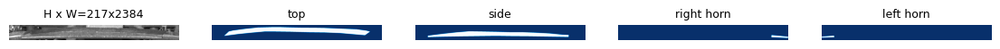

In [6]:
dataset = dataset_train
image_ids = dataset.image_ids
# image_ids = np.random.choice(dataset.image_ids, 3)
for image_id in image_ids:
    image = dataset.load_image(image_id)
    mask, class_ids = dataset.load_mask(image_id)
    display_top_masks(image, mask, class_ids, dataset.class_names, limit=4)  #limit to total number of classes

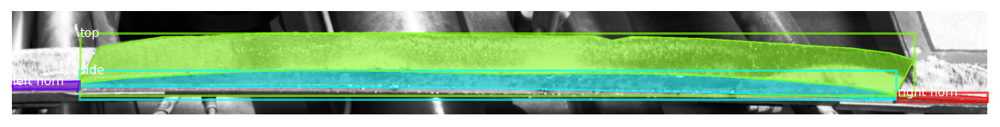

In [7]:
# define image id
image_id = 0
# load the image
image = dataset_train.load_image(image_id)
# load the masks and the class ids
mask, class_ids = dataset_train.load_mask(image_id)

# display_instances(image, r1['rois'], r1['masks'], r1['class_ids'],
# dataset.class_names, r1['scores'], ax=ax, title="Predictions1")

# extract bounding boxes from the masks
bbox = extract_bboxes(mask)
# display image with masks and bounding boxes
display_instances(image, bbox, mask, class_ids, dataset_train.class_names)


In [ ]:
# define a configuration for the model
class CustomConfig(Config):
    NAME = "custom_cfg_coco" # define the name of the configuration
    NUM_CLASSES = 1 + 4 # number of classes (background + ...classes)
    STEPS_PER_EPOCH = 100 # number of training steps per epoch
    #DETECTION_MIN_CONFIDENCE = 0.9 # Skip detections with < 90% confidence
    
# prepare config
config = CustomConfig()
config.display() 

## Train 1 model

In [ ]:
# define the model
model = MaskRCNN(mode='training', model_dir=DEFAULT_LOGS_DIR, config=config)
# load weights (mscoco) and exclude the output layers
model.load_weights(COCO_WEIGHTS_PATH, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",  "mrcnn_bbox", "mrcnn_mask"])
# train weights (output layers or 'heads')
model.train(dataset_train, dataset_val, learning_rate=config.LEARNING_RATE, epochs=25, layers='heads')

## Train models indef

In [ ]:
counter = 0
while True:
    model = MaskRCNN(mode='training', model_dir=DEFAULT_LOGS_DIR, config=config)
    model.load_weights(COCO_WEIGHTS_PATH, by_name=True, exclude=["mrcnn_class_logits", "mrcnn_bbox_fc",  "mrcnn_bbox", "mrcnn_mask"])
    model.train(dataset_train, dataset_val, learning_rate=config.LEARNING_RATE, epochs=25, layers='heads')
    dirname = f'trained-{int(datetime.timestamp(datetime.now()))}-{counter}'
    os.rename(os.path.join('logdir', 'train'), os.path.join('logdir', dirname))
    shutil.move(os.path.join('logdir', dirname), os.path.join('/', 'home', 'henrique.varela', 'weights'))
    model = None
    counter = counter + 1

# Predict

In [8]:
# define the prediction configuration
class PredictionConfig(Config):
    
    NAME = "prediction_cfg_coco" # define the name of the configuration
   
    NUM_CLASSES = 1 + 4  # number of classes (background + ...classes)
    # Set batch size to 1 since we'll be running inference on
            # one image at a time. Batch size = GPU_COUNT * IMAGES_PER_GPU
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    
# create config
cfg = PredictionConfig()

In [9]:
# calculate the mAP for a model on a given dataset
def evaluate_model(dataset, model, cfg):
    APs = list()
    for image_id in dataset.image_ids:
        # load image, bounding boxes and masks for the image id
        image, image_meta, gt_class_id, gt_bbox, gt_mask = load_image_gt(dataset, cfg, image_id, use_mini_mask=False)
        # convert pixel values (e.g. center)
        scaled_image = mold_image(image, cfg)
        # convert image into one sample
        sample = expand_dims(scaled_image, 0)
        # make prediction
        yhat = model.detect(sample, verbose=0)
        # extract results for first sample
        r = yhat[0]
        # calculate statistics, including AP
        AP, _, _, _ = compute_ap(gt_bbox, gt_class_id, gt_mask, r["rois"], r["class_ids"], r["scores"], r['masks'])
        # store
        APs.append(AP)
    # calculate the mean AP across all images
    mAP = mean(APs)
    return mAP

In [10]:
!ls /home/henrique.varela/weights

first_4_class  trained_4_class_1


In [11]:
WEIGHTS_PATH = os.path.join('/', 'home', 'henrique.varela', 'weights', 'trained_4_class_1', 'mask_rcnn_custom_cfg_coco_0023.h5')
# evaluate model on training dataset
model = MaskRCNN(mode='inference', model_dir=DEFAULT_LOGS_DIR, config=cfg)
model.load_weights(WEIGHTS_PATH, by_name=True)
train_mAP = evaluate_model(dataset_train, model, cfg)
print("Train mAP: %.3f" % train_mAP)

2024-10-31 09:09:39.967677: I tensorflow/core/platform/cpu_feature_guard.cc:145] This TensorFlow binary is optimized with Intel(R) MKL-DNN to use the following CPU instructions in performance critical operations:  AVX2 FMA
To enable them in non-MKL-DNN operations, rebuild TensorFlow with the appropriate compiler flags.


Train mAP: 0.860


In [ ]:
!ls pantograph-closeup/test

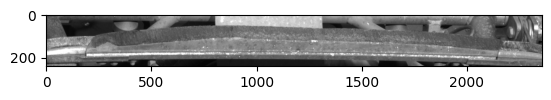

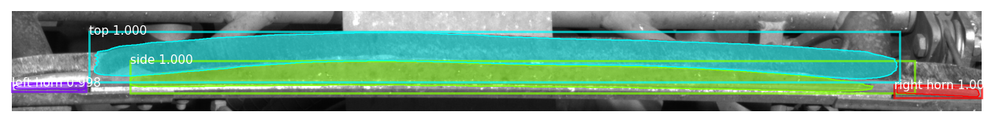

In [12]:
#Test on a single image
TEST_IMG = os.path.join('pantograph-closeup', 'test', '180504_0827412_SecondBrushOK1L.jpg')
test_img = cv2.imread(TEST_IMG)
plt.imshow(test_img)

detected = model.detect([test_img])
results = detected[0]
class_names = ['BG', 'side', 'top', 'left horn', 'right horn']
display_instances(test_img, results['rois'], results['masks'], 
                  results['class_ids'], class_names, results['scores'])

# Try every model checkpoint

In [13]:
weight_path = os.path.join('/', 'home', 'henrique.varela', 'weights', 'first_4_class')
weights = list(filter(lambda x: '.h5' in x, os.listdir(weight_path)))
weights.sort()
weights

['mask_rcnn_custom_cfg_coco_0001.h5',
 'mask_rcnn_custom_cfg_coco_0002.h5',
 'mask_rcnn_custom_cfg_coco_0003.h5',
 'mask_rcnn_custom_cfg_coco_0004.h5',
 'mask_rcnn_custom_cfg_coco_0005.h5',
 'mask_rcnn_custom_cfg_coco_0006.h5',
 'mask_rcnn_custom_cfg_coco_0007.h5',
 'mask_rcnn_custom_cfg_coco_0008.h5',
 'mask_rcnn_custom_cfg_coco_0009.h5',
 'mask_rcnn_custom_cfg_coco_0010.h5',
 'mask_rcnn_custom_cfg_coco_0011.h5',
 'mask_rcnn_custom_cfg_coco_0012.h5',
 'mask_rcnn_custom_cfg_coco_0013.h5',
 'mask_rcnn_custom_cfg_coco_0014.h5',
 'mask_rcnn_custom_cfg_coco_0015.h5',
 'mask_rcnn_custom_cfg_coco_0016.h5',
 'mask_rcnn_custom_cfg_coco_0017.h5',
 'mask_rcnn_custom_cfg_coco_0018.h5',
 'mask_rcnn_custom_cfg_coco_0019.h5',
 'mask_rcnn_custom_cfg_coco_0020.h5',
 'mask_rcnn_custom_cfg_coco_0021.h5',
 'mask_rcnn_custom_cfg_coco_0022.h5',
 'mask_rcnn_custom_cfg_coco_0023.h5',
 'mask_rcnn_custom_cfg_coco_0024.h5',
 'mask_rcnn_custom_cfg_coco_0025.h5']

mask_rcnn_custom_cfg_coco_0001.h5


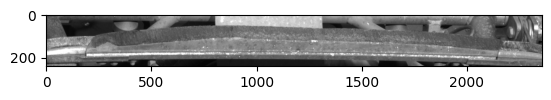

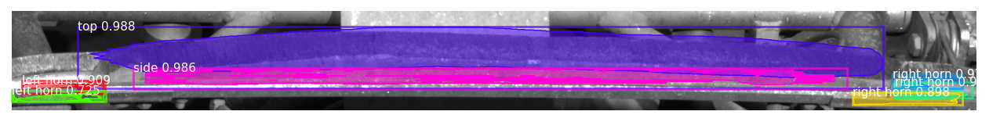

mask_rcnn_custom_cfg_coco_0002.h5


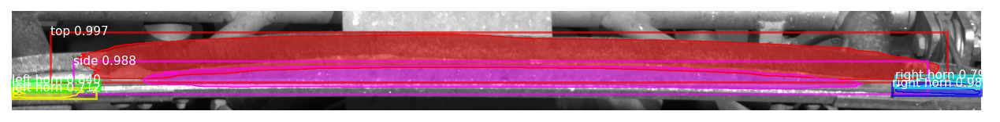

mask_rcnn_custom_cfg_coco_0003.h5


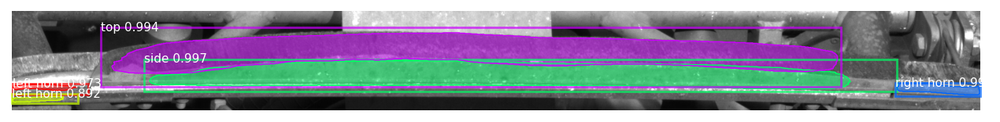

mask_rcnn_custom_cfg_coco_0004.h5


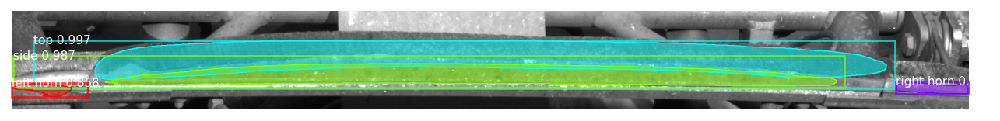

mask_rcnn_custom_cfg_coco_0005.h5


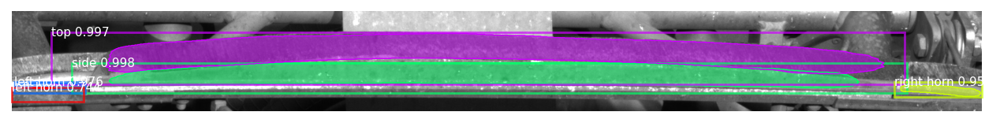

mask_rcnn_custom_cfg_coco_0006.h5


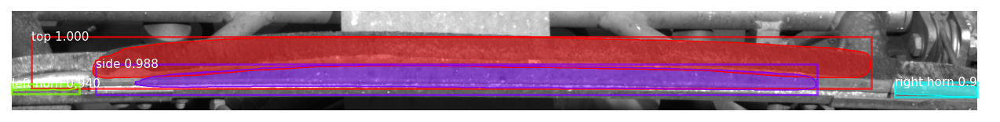

mask_rcnn_custom_cfg_coco_0007.h5


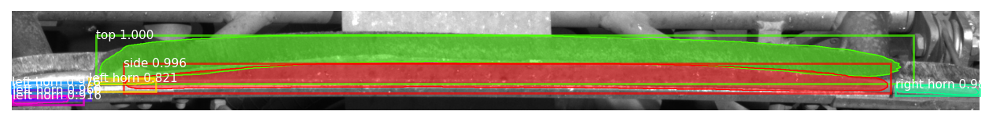

mask_rcnn_custom_cfg_coco_0008.h5


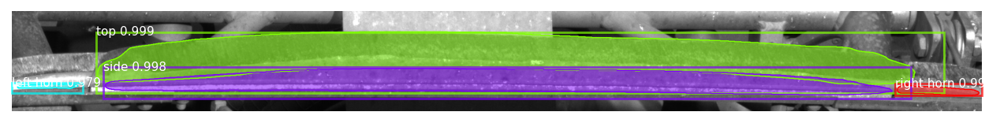

mask_rcnn_custom_cfg_coco_0009.h5


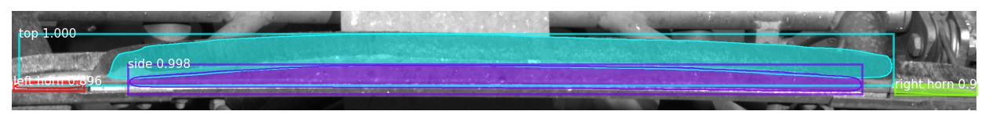

mask_rcnn_custom_cfg_coco_0010.h5


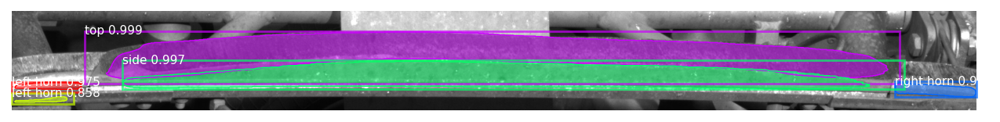

mask_rcnn_custom_cfg_coco_0011.h5


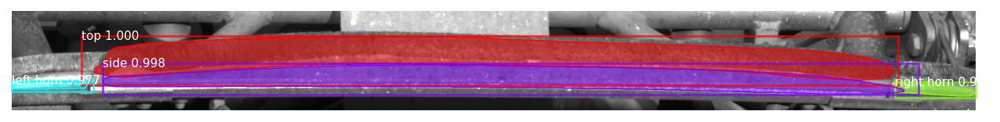

mask_rcnn_custom_cfg_coco_0012.h5


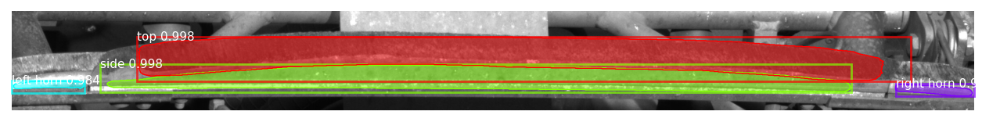

mask_rcnn_custom_cfg_coco_0013.h5


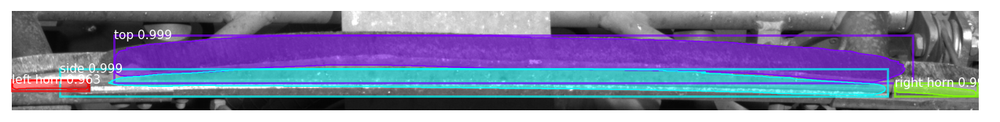

mask_rcnn_custom_cfg_coco_0014.h5


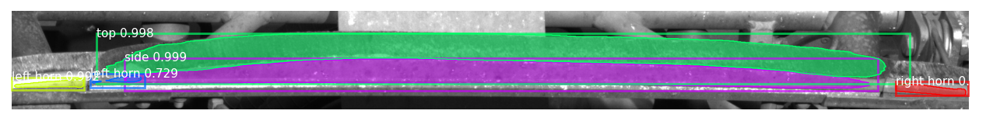

mask_rcnn_custom_cfg_coco_0015.h5


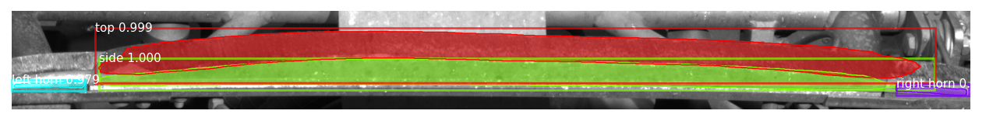

mask_rcnn_custom_cfg_coco_0016.h5


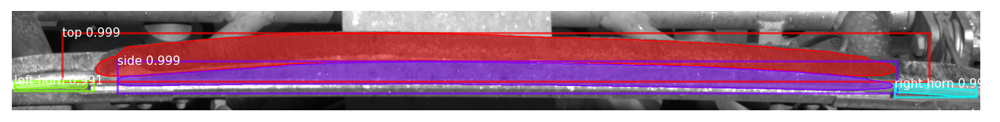

mask_rcnn_custom_cfg_coco_0017.h5


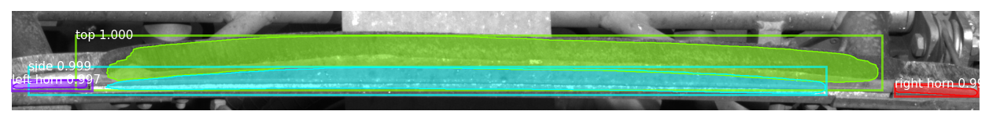

mask_rcnn_custom_cfg_coco_0018.h5


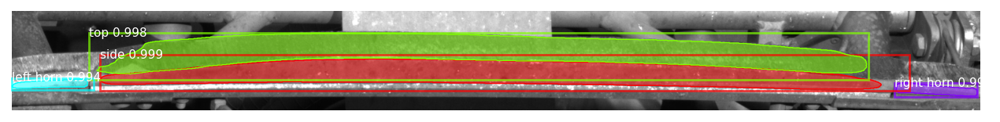

mask_rcnn_custom_cfg_coco_0019.h5


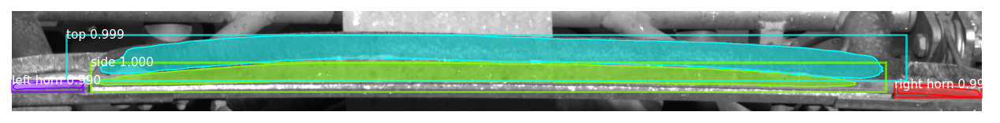

mask_rcnn_custom_cfg_coco_0020.h5


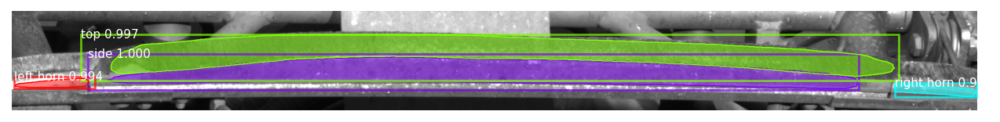

mask_rcnn_custom_cfg_coco_0021.h5


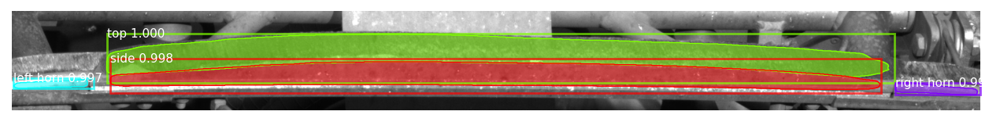

mask_rcnn_custom_cfg_coco_0022.h5


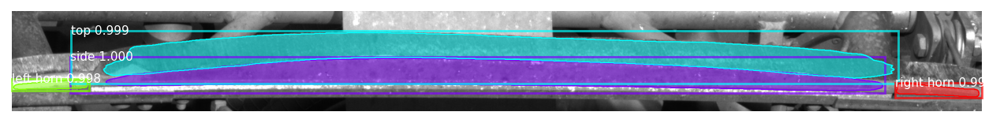

mask_rcnn_custom_cfg_coco_0023.h5


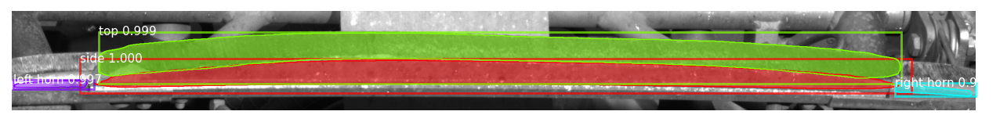

mask_rcnn_custom_cfg_coco_0024.h5


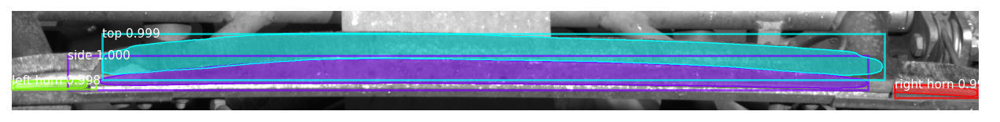

mask_rcnn_custom_cfg_coco_0025.h5


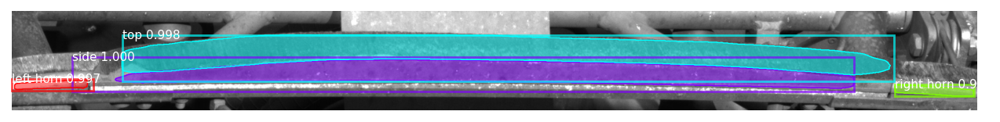

In [14]:
test_img = cv2.imread(TEST_IMG)
plt.imshow(test_img)

for weight in weights:
    model.load_weights(os.path.join(weight_path, weight), by_name=True)
    detected = model.detect([test_img])
    results = detected[0]
    class_names = ['BG', 'side', 'top', 'left horn', 'right horn']
    print(weight)
    display_instances(test_img, results['rois'], results['masks'], results['class_ids'], class_names, results['scores'])

# Try every image with model

mask_rcnn_custom_cfg_coco_0023.h5


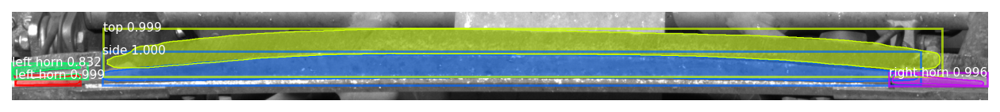

mask_rcnn_custom_cfg_coco_0023.h5


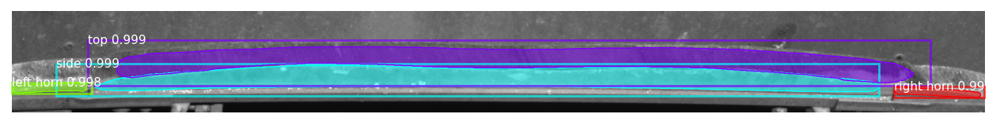

mask_rcnn_custom_cfg_coco_0023.h5


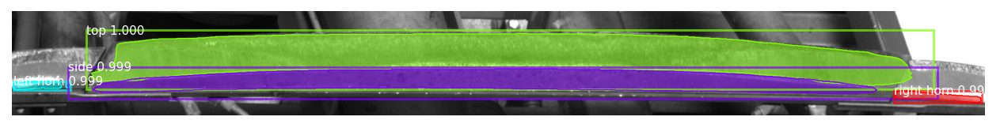

mask_rcnn_custom_cfg_coco_0023.h5


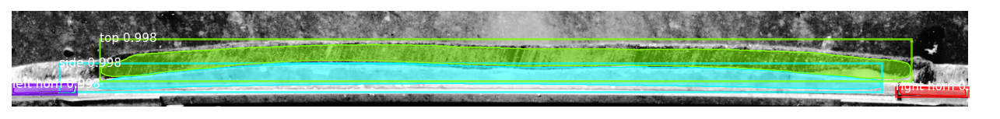

mask_rcnn_custom_cfg_coco_0023.h5


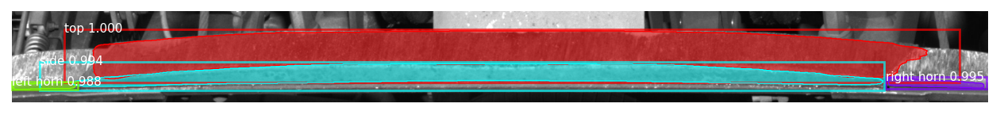

mask_rcnn_custom_cfg_coco_0023.h5


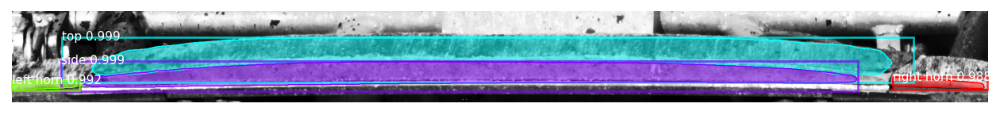

mask_rcnn_custom_cfg_coco_0023.h5


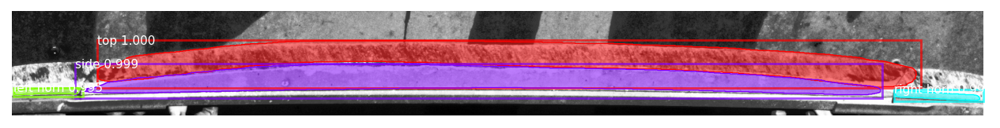

mask_rcnn_custom_cfg_coco_0023.h5


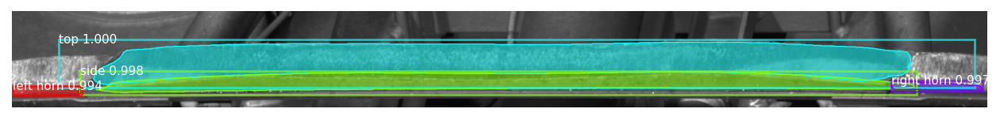

mask_rcnn_custom_cfg_coco_0023.h5


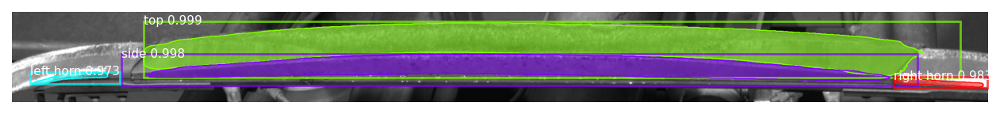

mask_rcnn_custom_cfg_coco_0023.h5


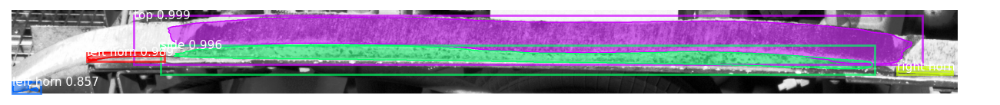

mask_rcnn_custom_cfg_coco_0023.h5


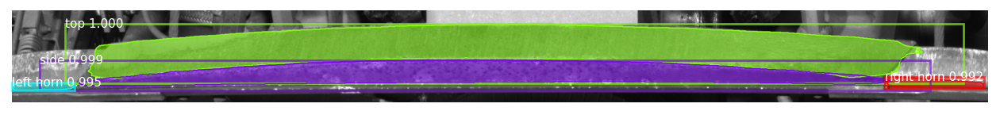

mask_rcnn_custom_cfg_coco_0023.h5


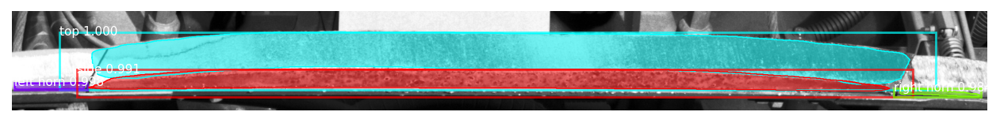

mask_rcnn_custom_cfg_coco_0023.h5


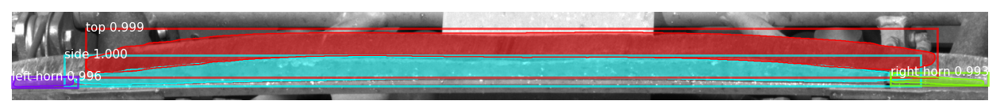

mask_rcnn_custom_cfg_coco_0023.h5


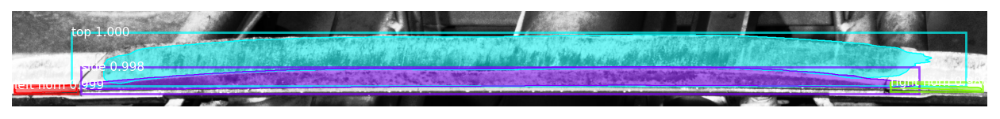

mask_rcnn_custom_cfg_coco_0023.h5


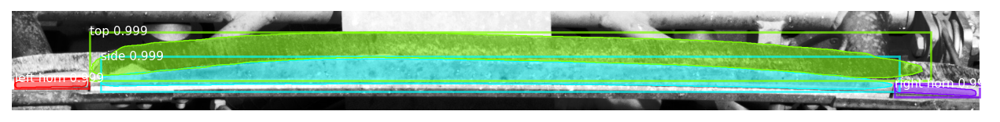

mask_rcnn_custom_cfg_coco_0023.h5


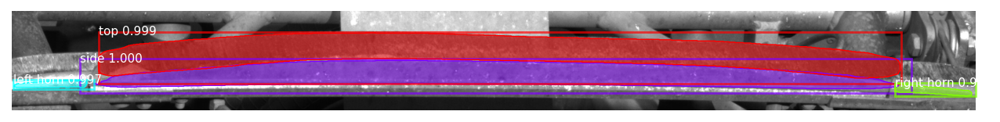

mask_rcnn_custom_cfg_coco_0023.h5


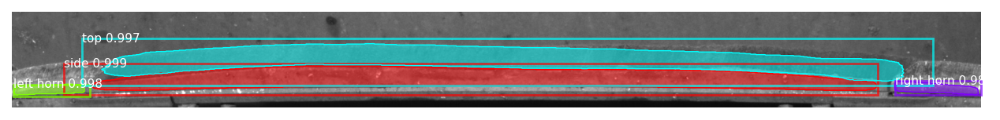

mask_rcnn_custom_cfg_coco_0023.h5


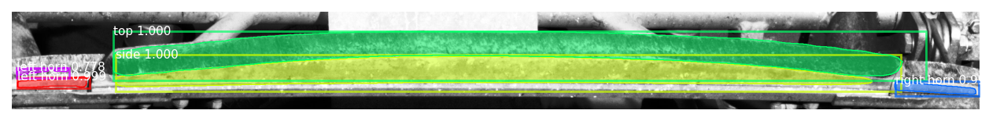

mask_rcnn_custom_cfg_coco_0023.h5


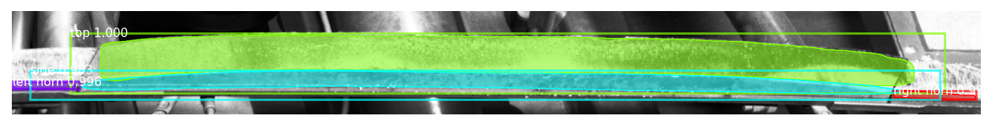

mask_rcnn_custom_cfg_coco_0023.h5


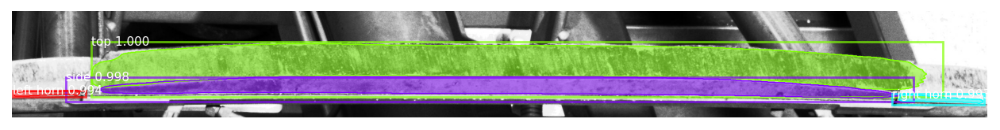

mask_rcnn_custom_cfg_coco_0023.h5


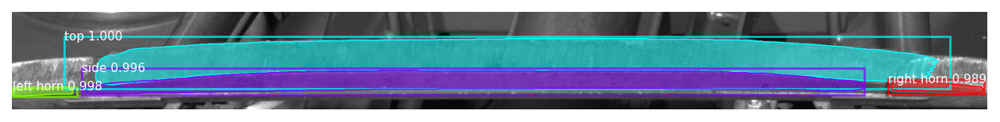

mask_rcnn_custom_cfg_coco_0023.h5


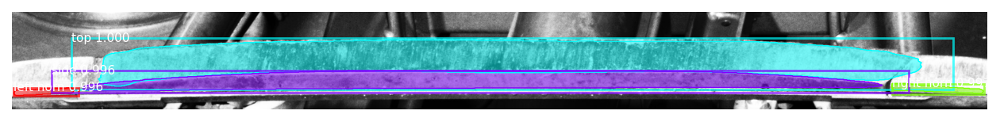

mask_rcnn_custom_cfg_coco_0023.h5


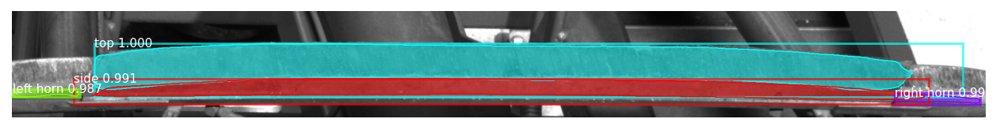

mask_rcnn_custom_cfg_coco_0023.h5


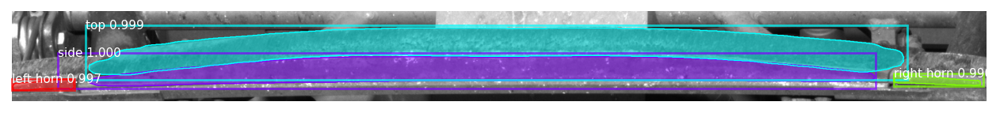

mask_rcnn_custom_cfg_coco_0023.h5


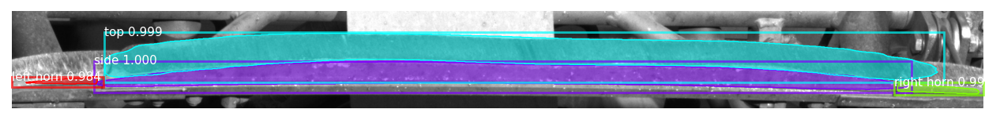

mask_rcnn_custom_cfg_coco_0023.h5


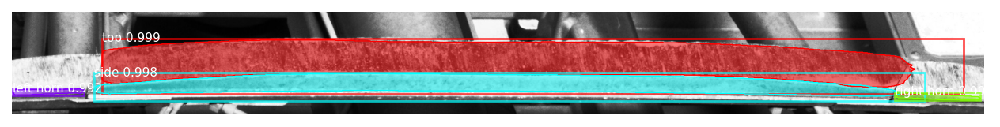

mask_rcnn_custom_cfg_coco_0023.h5


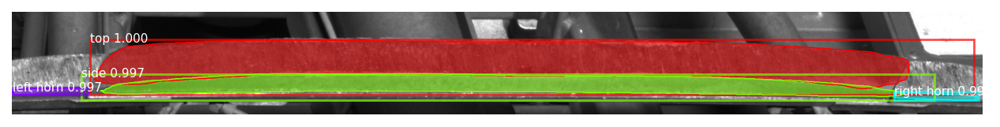

mask_rcnn_custom_cfg_coco_0023.h5


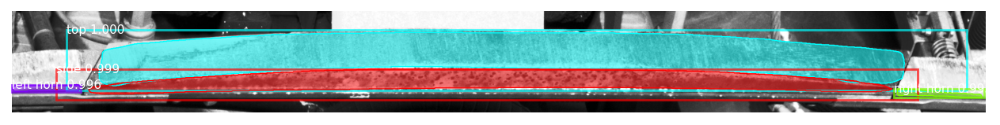

mask_rcnn_custom_cfg_coco_0023.h5


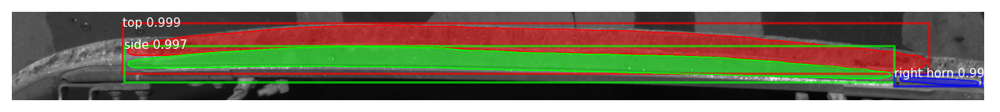

mask_rcnn_custom_cfg_coco_0023.h5


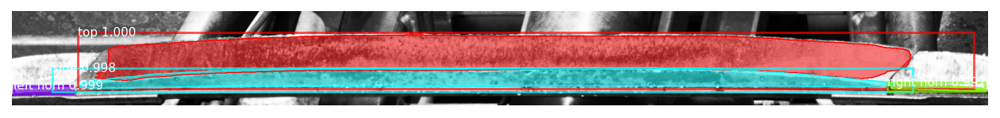

mask_rcnn_custom_cfg_coco_0023.h5


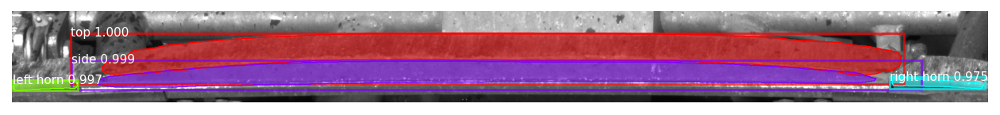

mask_rcnn_custom_cfg_coco_0023.h5


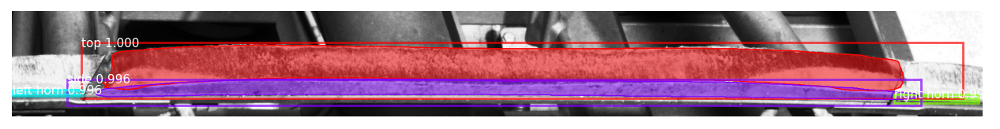

mask_rcnn_custom_cfg_coco_0023.h5


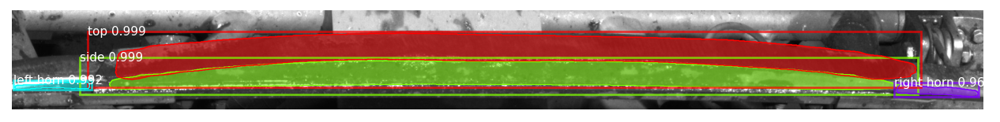

mask_rcnn_custom_cfg_coco_0023.h5


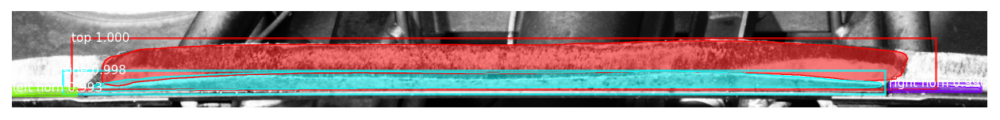

mask_rcnn_custom_cfg_coco_0023.h5


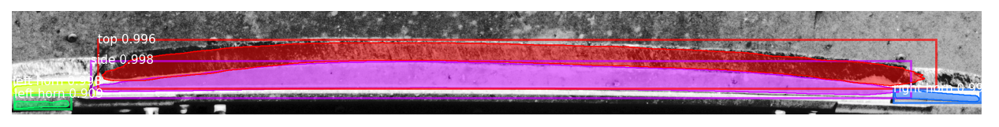

mask_rcnn_custom_cfg_coco_0023.h5


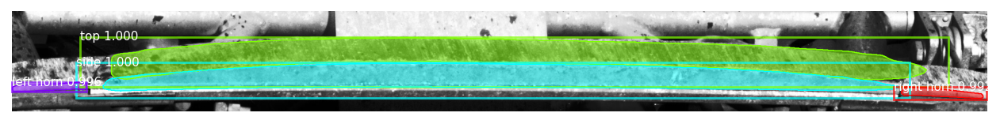

mask_rcnn_custom_cfg_coco_0023.h5


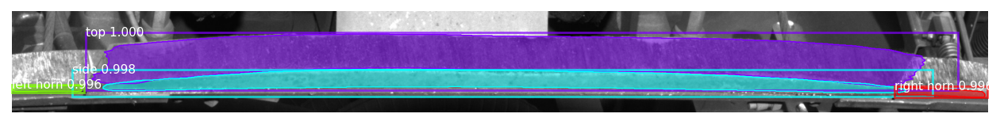

mask_rcnn_custom_cfg_coco_0023.h5


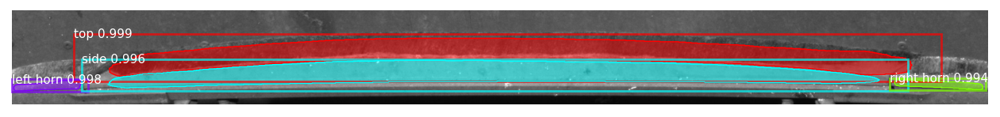

mask_rcnn_custom_cfg_coco_0023.h5


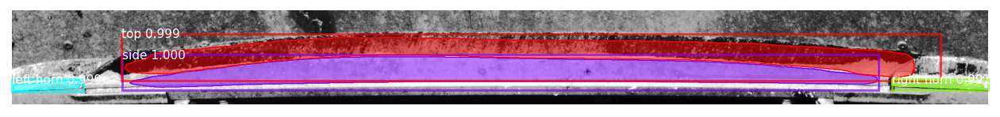

mask_rcnn_custom_cfg_coco_0023.h5


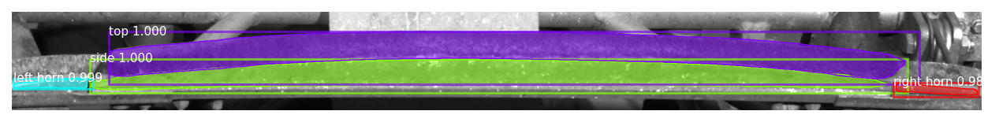

mask_rcnn_custom_cfg_coco_0023.h5


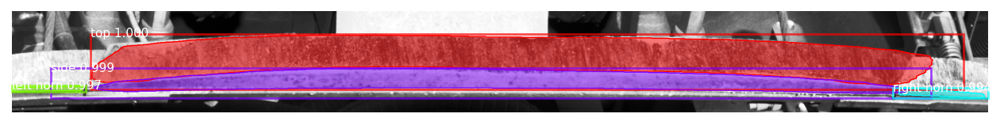

mask_rcnn_custom_cfg_coco_0023.h5


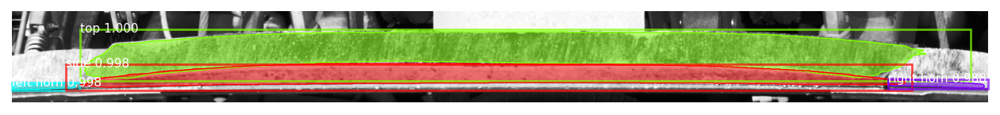

mask_rcnn_custom_cfg_coco_0023.h5


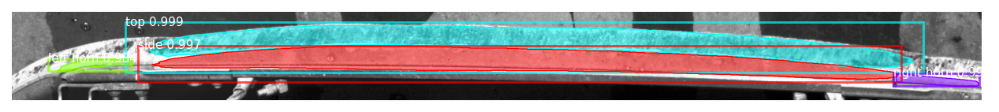

mask_rcnn_custom_cfg_coco_0023.h5


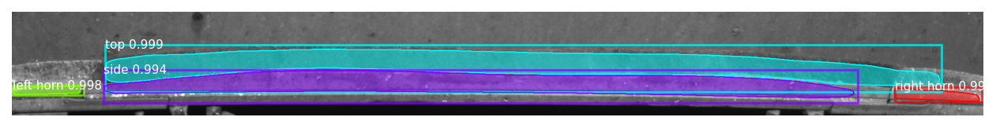

mask_rcnn_custom_cfg_coco_0023.h5


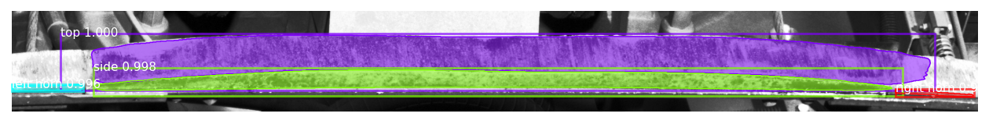

mask_rcnn_custom_cfg_coco_0023.h5


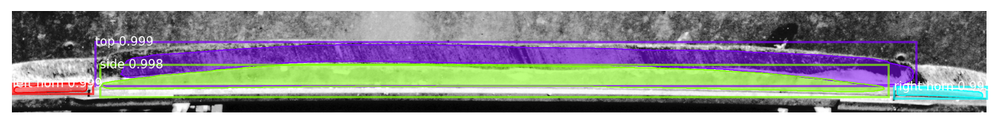

mask_rcnn_custom_cfg_coco_0023.h5


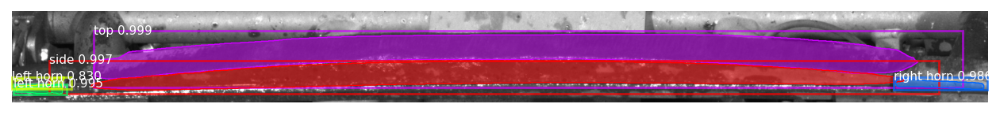

mask_rcnn_custom_cfg_coco_0023.h5


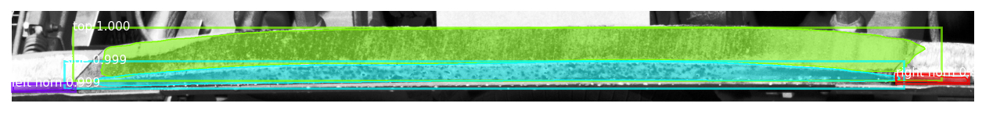

mask_rcnn_custom_cfg_coco_0023.h5


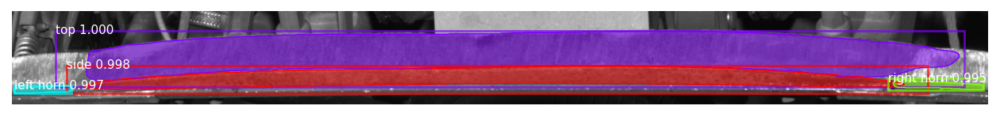

mask_rcnn_custom_cfg_coco_0023.h5


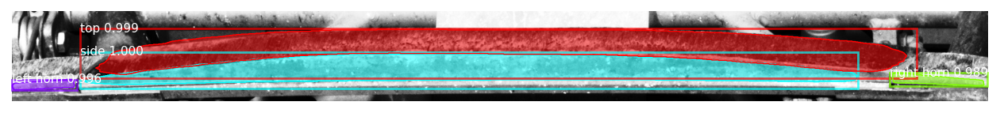

mask_rcnn_custom_cfg_coco_0023.h5


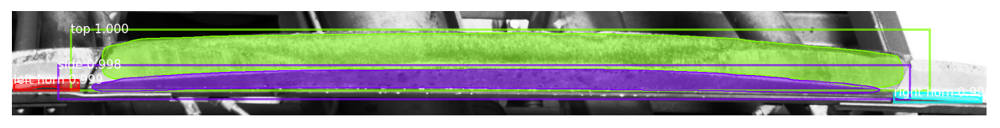

mask_rcnn_custom_cfg_coco_0023.h5


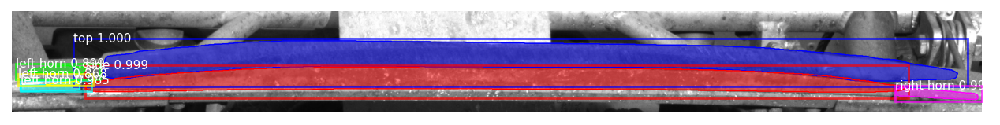

mask_rcnn_custom_cfg_coco_0023.h5


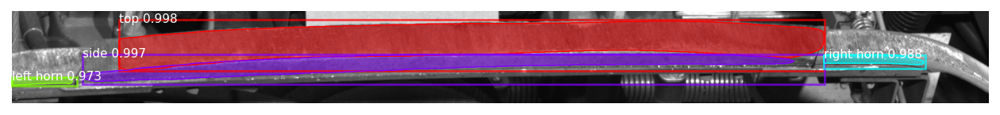

mask_rcnn_custom_cfg_coco_0023.h5


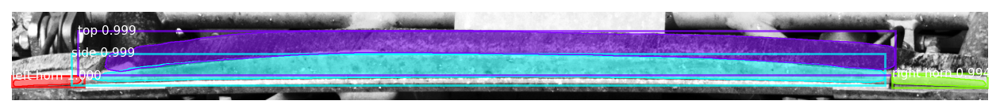

mask_rcnn_custom_cfg_coco_0023.h5


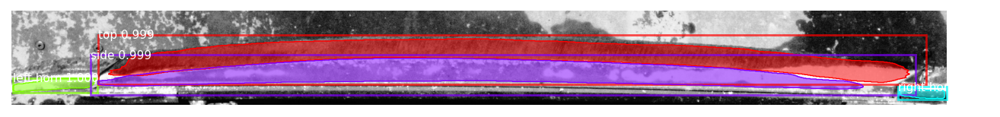

mask_rcnn_custom_cfg_coco_0023.h5


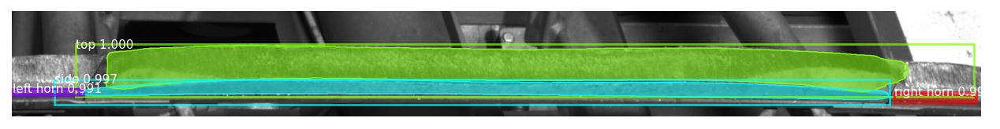

mask_rcnn_custom_cfg_coco_0023.h5


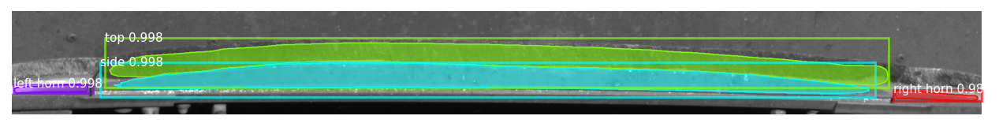

mask_rcnn_custom_cfg_coco_0023.h5


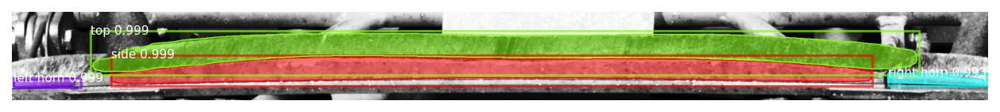

mask_rcnn_custom_cfg_coco_0023.h5


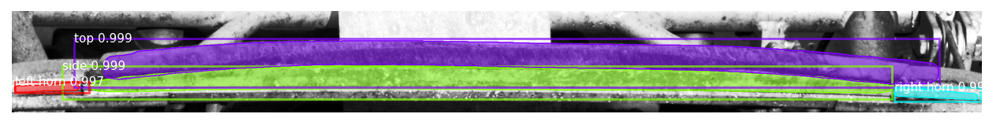

mask_rcnn_custom_cfg_coco_0023.h5


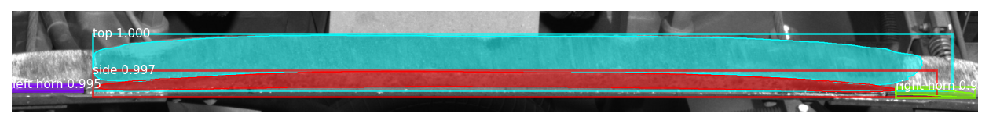

mask_rcnn_custom_cfg_coco_0023.h5


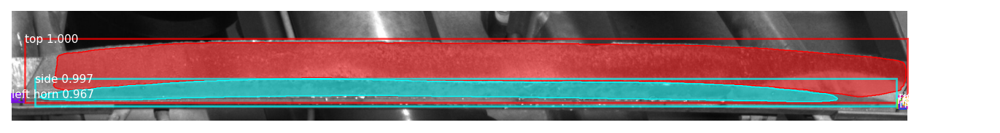

mask_rcnn_custom_cfg_coco_0023.h5


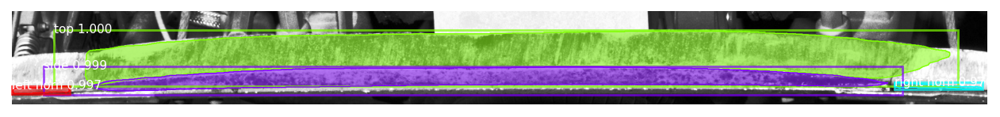

mask_rcnn_custom_cfg_coco_0023.h5


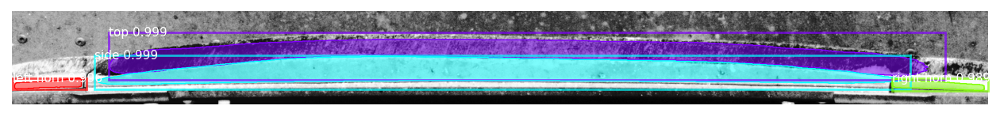

mask_rcnn_custom_cfg_coco_0023.h5


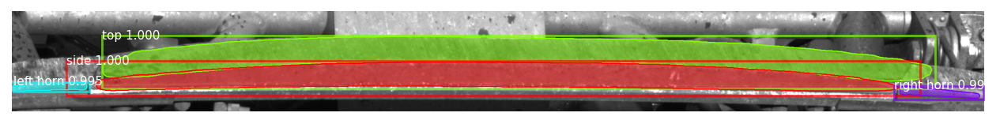

mask_rcnn_custom_cfg_coco_0023.h5


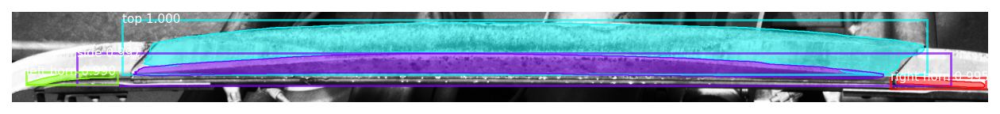

mask_rcnn_custom_cfg_coco_0023.h5


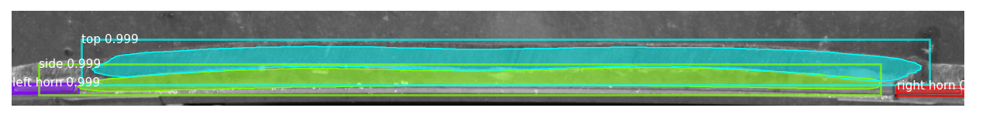

mask_rcnn_custom_cfg_coco_0023.h5


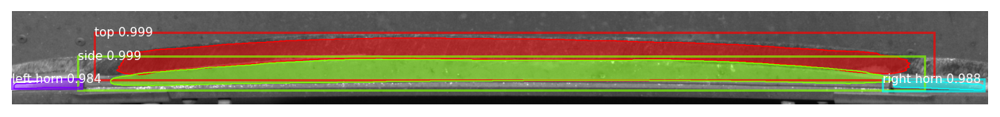

mask_rcnn_custom_cfg_coco_0023.h5


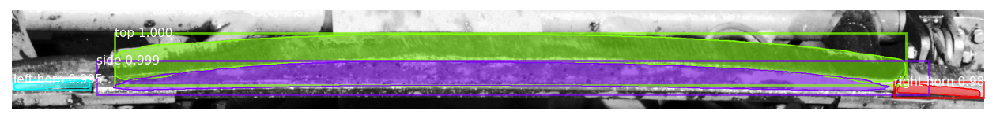

mask_rcnn_custom_cfg_coco_0023.h5


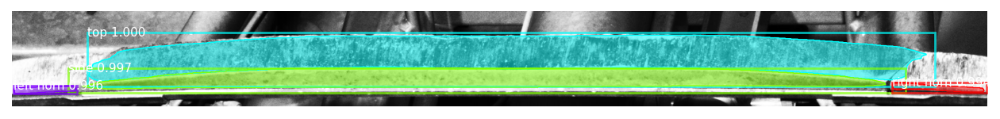

mask_rcnn_custom_cfg_coco_0023.h5


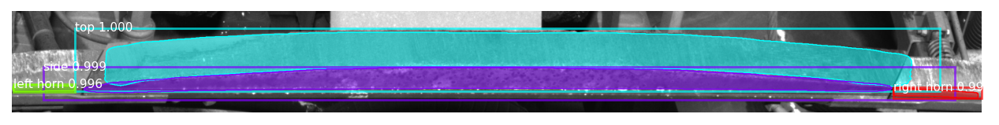

mask_rcnn_custom_cfg_coco_0023.h5


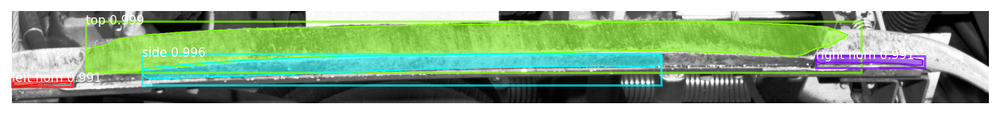

mask_rcnn_custom_cfg_coco_0023.h5


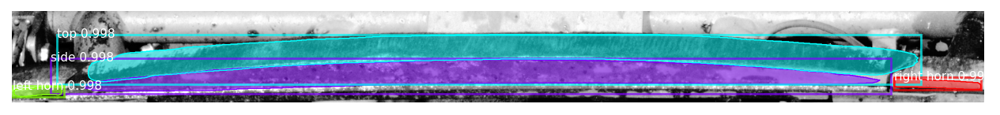

mask_rcnn_custom_cfg_coco_0023.h5


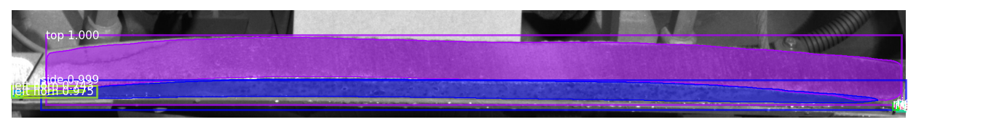

mask_rcnn_custom_cfg_coco_0023.h5


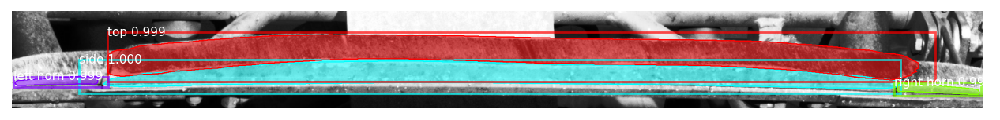

mask_rcnn_custom_cfg_coco_0023.h5


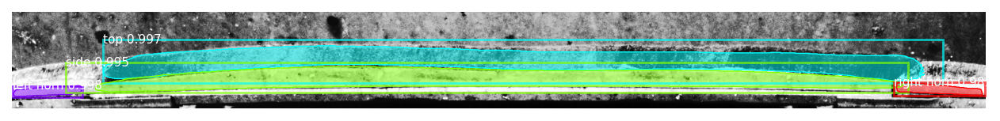

mask_rcnn_custom_cfg_coco_0023.h5


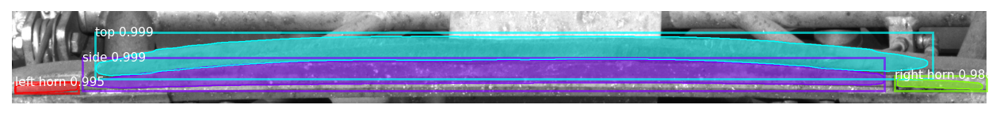

mask_rcnn_custom_cfg_coco_0023.h5


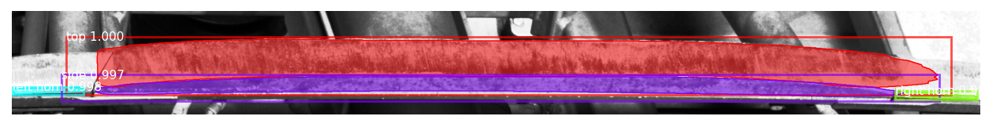

mask_rcnn_custom_cfg_coco_0023.h5


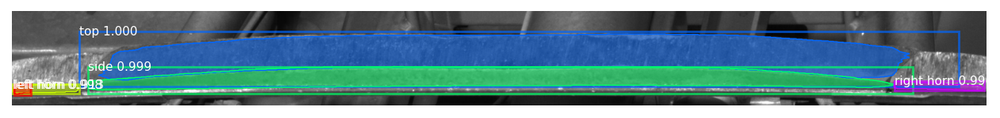

mask_rcnn_custom_cfg_coco_0023.h5


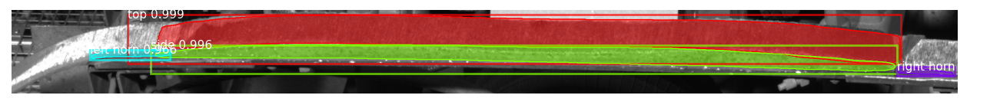

mask_rcnn_custom_cfg_coco_0023.h5


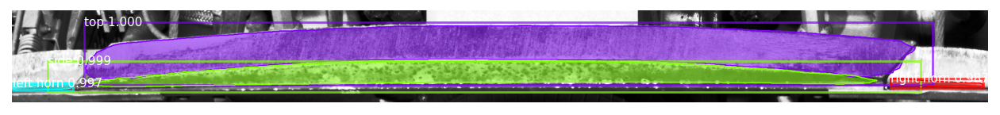

In [15]:
weight = 'mask_rcnn_custom_cfg_coco_0023.h5'
model.load_weights(os.path.join(weight_path, weight), by_name=True)
images = os.listdir(IMAGES)
for img in images:
    test_img = cv2.imread(os.path.join(IMAGES, img))
    detected = model.detect([test_img])
    results = detected[0]
    class_names = ['BG', 'side', 'top', 'left horn', 'right horn']
    print(weight)
    display_instances(test_img, results['rois'], results['masks'], results['class_ids'], class_names, results['scores'])

In [ ]:
import sys
def e():
    def sizeof_fmt(num, suffix='B'):
        ''' by Fred Cirera,  https://stackoverflow.com/a/1094933/1870254, modified'''
        for unit in ['','Ki','Mi','Gi','Ti','Pi','Ei','Zi']:
            if abs(num) < 1024.0:
                return "%3.1f %s%s" % (num, unit, suffix)
            num /= 1024.0
        return "%.1f %s%s" % (num, 'Yi', suffix)

    for name, size in sorted(((name, sys.getsizeof(value)) for name, value in list(
                              locals().items())), key= lambda x: -x[1])[:10]:
        print("{:>30}: {:>8}".format(name, sizeof_fmt(size)))